In [0]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

## Importing & Cleaning  Wildfires Dataframe

In [0]:
Historical_Wildfires_df = spark.read.format('csv').options(header='true').load('dbfs:/FileStore/tables/Historical_Wildfires.csv').toPandas()


In [0]:
Historical_Wildfires_df.shape

(26406, 10)

In [0]:
Historical_Wildfires_df['Date'] = pd.to_datetime(Historical_Wildfires_df['Date'])
columns_to_convert = ["Estimated_fire_area", "Mean_estimated_fire_brightness", 
                      "Mean_estimated_fire_radiative_power", "Mean_confidence", 
                      "Std_confidence", "Var_confidence", "Count"]

Historical_Wildfires_df[columns_to_convert] = Historical_Wildfires_df[columns_to_convert].astype(float)
print(Historical_Wildfires_df.dtypes)

Region                                         object
Date                                   datetime64[ns]
Estimated_fire_area                           float64
Mean_estimated_fire_brightness                float64
Mean_estimated_fire_radiative_power           float64
Mean_confidence                               float64
Std_confidence                                float64
Var_confidence                                float64
Count                                         float64
Replaced                                       object
dtype: object


In [0]:
Historical_Wildfires_df['Year'] = Historical_Wildfires_df['Date'].dt.year
Historical_Wildfires_df['Month'] = Historical_Wildfires_df['Date'].dt.month

In [0]:
display(Historical_Wildfires_df)

Region,Date,Estimated_fire_area,Mean_estimated_fire_brightness,Mean_estimated_fire_radiative_power,Mean_confidence,Std_confidence,Var_confidence,Count,Replaced,Year,Month
NSW,2005-01-04T00:00:00Z,8.68,312.2666667,42.4,78.66666667,2.886751346,8.333333333,3.0,R,2005,1
NSW,2005-01-05T00:00:00Z,16.61125,322.475,62.3625,85.5,8.088792953,65.42857143,8.0,R,2005,1
NSW,2005-01-06T00:00:00Z,5.52,325.2666667,38.4,78.33333333,3.214550254,10.33333333,3.0,R,2005,1
NSW,2005-01-07T00:00:00Z,6.264,313.87,33.8,92.2,7.529940239,56.7,5.0,R,2005,1
NSW,2005-01-08T00:00:00Z,5.4,337.3833333,122.5333333,91.0,7.937253933,63.0,3.0,R,2005,1
NSW,2005-01-09T00:00:00Z,13.72142857,314.7571429,64.54285714,83.14285714,6.175990377,38.14285714,7.0,R,2005,1
NSW,2005-01-10T00:00:00Z,16.62545455,324.8,58.55454545,91.45454545,6.088737741,37.07272727,11.0,R,2005,1
NSW,2005-01-11T00:00:00Z,32.784375,318.446875,66.8125,91.0,10.1324561,102.6666667,16.0,R,2005,1
NSW,2005-01-12T00:00:00Z,16.48615385,323.2384615,40.60769231,87.76923077,8.623164985,74.35897436,13.0,R,2005,1
NSW,2005-01-13T00:00:00Z,42.64,325.3766667,87.57333333,86.66666667,7.499206307,56.23809524,15.0,R,2005,1


#### Estimated fire area will be the target variable for our problem statement. 
Other columns are diagonistic data that should be deleted as these columns will be generated only after the prediction

In [0]:
Historical_Wildfires_df.drop(['Var_confidence', 'Mean_confidence', 'Std_confidence', 'Count','Replaced', 'Mean_estimated_fire_radiative_power', 'Mean_estimated_fire_brightness'], axis = 1, inplace=True)


#### Checking for Negative & Duplicate values

In [0]:
#checking for negative values
temp = Historical_Wildfires_df.drop(['Region', 'Date', 'Month'], axis =1)

negative_values = temp < 0

# Sum negative values by columns
sum_negative_values_by_column = negative_values.sum()
sum_negative_values_by_column

Estimated_fire_area    0
Year                   0
dtype: int64

In [0]:
# No duplicate values
Historical_Wildfires_df.duplicated().sum() 

0

In [0]:
Historical_Wildfires_df['Estimated_fire_area'].fillna(0, inplace=True)

In [0]:
Historical_Wildfires_df.display()

Region,Date,Estimated_fire_area,Year,Month
NSW,2005-01-04T00:00:00Z,8.68,2005,1
NSW,2005-01-05T00:00:00Z,16.61125,2005,1
NSW,2005-01-06T00:00:00Z,5.52,2005,1
NSW,2005-01-07T00:00:00Z,6.264,2005,1
NSW,2005-01-08T00:00:00Z,5.4,2005,1
NSW,2005-01-09T00:00:00Z,13.72142857,2005,1
NSW,2005-01-10T00:00:00Z,16.62545455,2005,1
NSW,2005-01-11T00:00:00Z,32.784375,2005,1
NSW,2005-01-12T00:00:00Z,16.48615385,2005,1
NSW,2005-01-13T00:00:00Z,42.64,2005,1


## Importing & Cleaning Weather Dataframe

In [0]:
weather_df = spark.read.format('csv').options(header='true').load('dbfs:/FileStore/tables/HistoricalWeather.csv').toPandas()

In [0]:
weather_df.shape

(242781, 8)

In [0]:
# Renaming Columns
weather_df = weather_df.rename(columns={"count()[unit: km^2]": "Area", "min()": "Min",
                                       "max()": "Max", "mean()": "Mean", "variance()": "Variance"})


#### Pivoting the Weather table

In [0]:
# Reformat the data
weather_df['Date'] = pd.to_datetime(weather_df['Date'])
df_pivot = weather_df.pivot_table(values=['Min','Max','Mean','Variance'], index=['Date','Region'],
                                  columns=['Parameter'])
# Reset dataframe index
df_pivot.reset_index(inplace=True)

# Renaming Column names
df_pivot.columns = [col[0] if not(col[1]) else '{1}_{0}'.format(*col) for col in df_pivot.columns.values]

# Rearranging Data and column
params = df_pivot.columns.tolist()[3:]
params.sort()
weather_data = df_pivot[df_pivot.columns.tolist()[:3] + params].copy()

In [0]:
# Creating 3 new columns - helpful while joining tables
weather_data['Year'] = weather_data['Date'].dt.year
weather_data['Month'] = weather_data['Date'].dt.month

In [0]:
# Check for missing values in weather_data
weather_data.isnull().sum()

Date                          0
Region                        0
Precipitation_Max             7
Precipitation_Mean            7
Precipitation_Min             7
Precipitation_Variance        7
RelativeHumidity_Max         42
RelativeHumidity_Mean        42
RelativeHumidity_Min         42
RelativeHumidity_Variance    42
SoilWaterContent_Max          0
SoilWaterContent_Mean         0
SoilWaterContent_Min          0
SoilWaterContent_Variance     0
SolarRadiation_Max           14
SolarRadiation_Mean          14
SolarRadiation_Min           14
SolarRadiation_Variance      14
Temperature_Max              14
Temperature_Mean             14
Temperature_Min              14
Temperature_Variance         14
WindSpeed_Max                28
WindSpeed_Mean               28
WindSpeed_Min                28
WindSpeed_Variance           28
Year                          0
Month                         0
dtype: int64

In [0]:
# Impute missing values with 0
weather_data.fillna(0, inplace=True)

In [0]:
display(weather_data)

Date,Region,Precipitation_Max,Precipitation_Mean,Precipitation_Min,Precipitation_Variance,RelativeHumidity_Max,RelativeHumidity_Mean,RelativeHumidity_Min,RelativeHumidity_Variance,SoilWaterContent_Max,SoilWaterContent_Mean,SoilWaterContent_Min,SoilWaterContent_Variance,SolarRadiation_Max,SolarRadiation_Mean,SolarRadiation_Min,SolarRadiation_Variance,Temperature_Max,Temperature_Mean,Temperature_Min,Temperature_Variance,WindSpeed_Max,WindSpeed_Mean,WindSpeed_Min,WindSpeed_Variance,Year,Month
2005-01-01T00:00:00Z,NSW,1.83693528175354,0.044274442233515995,0.0,0.02836210061080505,80.52296447753906,36.355567174428224,13.877194404602053,253.5599369788299,0.414304912090302,0.170931136206725,0.002244789851829,0.007758409830720018,32.16978073120117,26.749388640628453,14.515008926391602,6.078586621582531,35.87870407104492,27.34118187347965,14.485784530639648,18.56221200574396,7.6704816818237305,3.3235495014184777,1.354447603225708,0.8500476421069205,2005,1
2005-01-01T00:00:00Z,NT,315.2668151855469,9.884957682481286,0.0,546.0592622736414,95.68334197998048,61.4946747437193,14.558819770812988,584.2011308062993,0.496140271425247,0.167735240632696,0.0,0.02674280275319358,31.63445854187012,19.78179070248108,2.518119812011719,58.942657732507655,38.13678741455078,29.88149218395819,24.17996025085449,12.920252299589947,9.704401969909668,5.296891761974689,1.8403939008712769,1.9300137039341045,2005,1
2005-01-01T00:00:00Z,QL,74.45216369628906,1.453052700944846,0.0,35.6412565108321,95.89826965332031,47.95936419870832,14.443199157714846,403.13437697520476,0.47241625189781206,0.185641395682371,0.0,0.012678895530836364,31.982830047607425,27.05697868021628,6.03382682800293,29.50083241808295,37.047943115234375,28.84286596072678,20.95162010192871,13.79259859078661,7.675631999969482,3.483753305650359,1.106027841567993,0.8830476067173212,2005,1
2005-01-01T00:00:00Z,SA,3.1936244964599614,0.05907846285384501,0.0,0.042837407766545856,81.98075103759766,30.057682790370606,10.618136405944824,246.04471291862205,0.263910830020905,0.056046618303255004,0.0,0.0019169026994112414,31.734527587890625,27.14264252913578,17.861103057861328,7.914246277578741,38.326847076416016,30.793675222828547,14.095854759216307,34.79933647839198,10.04471492767334,4.65753846667346,2.023657321929932,1.6559084795332524,2005,1
2005-01-01T00:00:00Z,TA,13.604790687561035,3.099497068910544,0.003972991835326,12.068597111463966,81.5014419555664,65.08676404087721,43.90657424926758,111.75403428397112,0.368189066648483,0.21136034014481303,0.0,0.007120831127055943,33.22551727294921,26.75571119931565,20.74230194091797,12.826400085075647,16.2285099029541,11.78880460068683,6.686816215515138,4.912012950020568,11.432408332824707,5.408137732760589,1.995646595954895,2.9631178724168556,2005,1
2005-01-01T00:00:00Z,VI,1.129022598266602,0.05202351351541901,0.0,0.013255388028640017,80.26942443847656,56.45655911313808,31.75429344177246,135.49120669229933,0.389526903629303,0.19755944791908997,0.0,0.005087701916239376,30.274398803710934,24.623813329999344,14.143863677978516,9.162359029629897,25.29929542541504,17.084567628209008,11.722956657409668,9.465103276896912,9.830580711364746,3.655508479497904,1.358904838562012,1.0494868664116161,2005,1
2005-01-01T00:00:00Z,WA,127.79518127441406,1.8724147486695157,0.0,56.7717652913071,90.39925384521484,49.027855276376314,16.94204330444336,260.72101537181925,0.405102074146271,0.075727521423318,0.0,0.0037129814200539124,32.819297790527344,26.967495061198488,4.060163974761963,19.931596449598487,36.41108322143555,28.524054822596568,18.385499954223636,17.695983630392334,10.65023708343506,4.2010390340744825,0.9313962459564209,1.4096768096754246,2005,1
2005-01-02T00:00:00Z,NSW,6.854537010192871,0.173878952258094,0.0,0.2713856312193325,86.24382781982422,38.699606899069465,20.738882064819336,224.76925274571227,0.404070645570755,0.169551401651261,0.001209517358802,0.007292911301036764,34.308486938476555,27.047523006324862,15.775054931640625,11.737576671708212,33.97660446166992,26.14389774

## Importing & Cleaning  Vegetation Dataframe

In [0]:
VegetationIndex_df = spark.read.format('csv').options(header='true').load('dbfs:/FileStore/tables/VegetationIndex.csv').toPandas()

In [0]:
VegetationIndex_df.shape

(1330, 7)

In [0]:
# Fixing datatypes and renaming columns
VegetationIndex_df['Date'] = pd.to_datetime(VegetationIndex_df['Date'])

columns_to_convert = ["Vegetation_index_mean", "Vegetation_index_max", 
                      "Vegetation_index_min", "Vegetation_index_std", 
                      "Vegetation_index_variance"]

VegetationIndex_df[columns_to_convert] = VegetationIndex_df[columns_to_convert].astype(float)

In [0]:
# Creating 3 new columns - helpful while joining tables

VegetationIndex_df['Year'] = VegetationIndex_df['Date'].dt.year
VegetationIndex_df['Month'] = VegetationIndex_df['Date'].dt.month

In [0]:
display(VegetationIndex_df)

Region,Date,Vegetation_index_mean,Vegetation_index_max,Vegetation_index_min,Vegetation_index_std,Vegetation_index_variance,Year,Month
NSW,2005-01-01T00:00:00Z,0.349202013,0.997199953,-0.199999988,0.204861658,0.041968299,2005,1
NSW,2005-02-01T00:00:00Z,0.35740272,0.977199972,-0.199999988,0.208672808,0.043544341,2005,2
NSW,2005-03-01T00:00:00Z,0.354086901,0.974999964,-0.199999988,0.209450457,0.043869494,2005,3
NSW,2005-04-01T00:00:00Z,0.347242212,0.990399957,-0.199999988,0.207306677,0.042976058,2005,4
NSW,2005-05-01T00:00:00Z,0.345525727,0.997199953,-0.199999988,0.202858051,0.041151389,2005,5
NSW,2005-06-01T00:00:00Z,0.399652424,0.960199952,-0.199999988,0.188569978,0.035558637,2005,6
NSW,2005-07-01T00:00:00Z,0.451143018,0.955499947,-0.199999988,0.174266677,0.030368875,2005,7
NSW,2005-08-01T00:00:00Z,0.498218123,0.978199959,-0.199999988,0.181103059,0.032798318,2005,8
NSW,2005-09-01T00:00:00Z,0.505553223,0.980499983,-0.199999988,0.204202021,0.041698465,2005,9
NSW,2005-10-01T00:00:00Z,0.439442725,0.981399953,-0.199999988,0.214670716,0.046083517,2005,10


## Importing & Cleaning Land Class Dataframe

In [0]:
LandClass_df = spark.read.format('csv').options(header='true').load('dbfs:/FileStore/tables/LandClass.csv').toPandas()

In [0]:
LandClass_df.shape

(7, 15)

In [0]:
# Fixing data types
columns_to_convert = ['Herbaceous vegetation',
                     'Cultivated and managed vegetation/agriculture (cropland)',
                     'Urban / built up',
                     'Bare / sparse vegetation',
                     'Permanent water bodies',
                     'Herbaceous wetland',
                     'Closed forest, evergreen, broad leaf',
                     'Closed forest, deciduous broad leaf',
                     'Closed forest, unknown',
                     'Open forest, evergreen broad leaf',
                     'Open forest, deciduous broad leaf',
                     'Open forest, unknown definitions',
                     'Open sea']

LandClass_df[columns_to_convert] = LandClass_df[columns_to_convert].astype(float)
display(LandClass_df)

Region,Shrubs,Herbaceous vegetation,Cultivated and managed vegetation/agriculture (cropland),Urban / built up,Bare / sparse vegetation,Permanent water bodies,Herbaceous wetland,"Closed forest, evergreen, broad leaf","Closed forest, deciduous broad leaf","Closed forest, unknown","Open forest, evergreen broad leaf","Open forest, deciduous broad leaf","Open forest, unknown definitions",Open sea
NSW,6.2,43.6,13.0,0.3,0.2,0.2,0.1,14.7,6.8,0.3,0.5,3.7,10.3,0.1
NT,18.1,48.9,0.1,0.0,0.4,0.1,0.1,1.0,7.7,0.1,0.1,13.6,9.3,0.5
QL,9.5,45.3,1.6,0.1,1.1,0.1,0.0,5.3,13.3,0.3,0.1,12.0,11.0,0.3
SA,24.1,54.8,5.8,0.1,4.8,1.2,0.1,0.3,1.3,0.1,0.1,1.4,5.3,0.6
TA,0.7,23.8,1.2,0.2,0.1,1.9,1.4,50.1,0.6,1.1,7.2,1.5,7.2,3.0
WA,31.3,43.5,5.6,0.0,1.0,0.4,0.0,1.2,2.4,0.2,0.1,4.8,8.7,0.8
VI,1.4,35.0,23.3,1.0,0.1,0.6,0.3,23.9,3.8,0.3,1.5,2.7,5.2,0.9


# Exploratory Data Analysis

## Wildfire Dataframe

In [0]:
Historical_Wildfires_df['Region'].value_counts()

WA     5627
QL     5533
NT     5053
NSW    4623
VI     2176
SA     1990
TA     1404
Name: Region, dtype: int64

### Visualizing Estimated_fire_area over the years

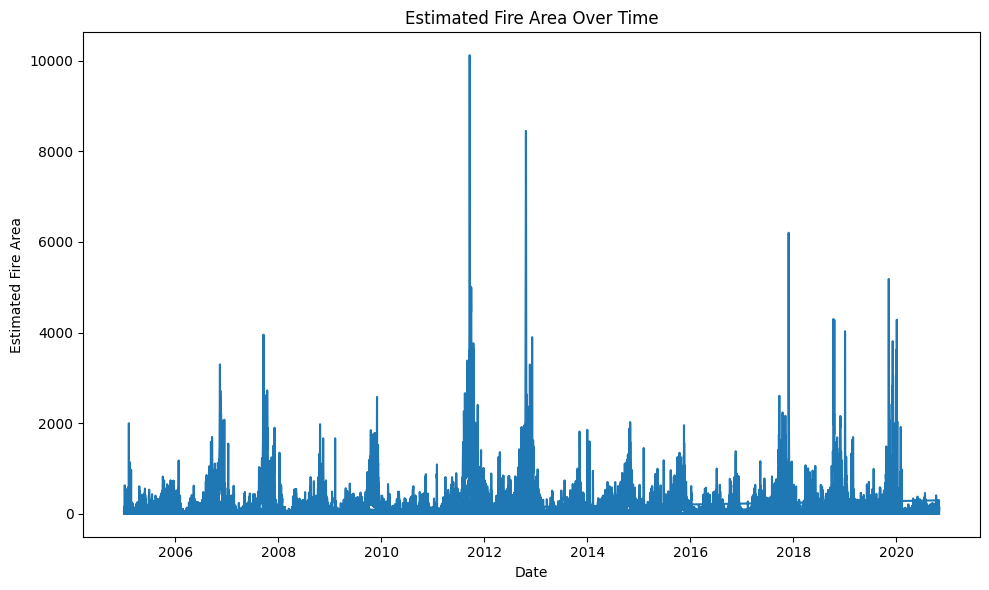

In [0]:
plt.figure(figsize=(10, 6))
plt.plot(Historical_Wildfires_df['Date'], Historical_Wildfires_df['Estimated_fire_area'])
plt.title('Estimated Fire Area Over Time')
plt.xlabel('Date')
plt.ylabel('Estimated Fire Area')
plt.grid(False)
plt.tight_layout()
plt.show()

#### Fixing Ouliers - Imputing values higher than 3000 with 3000

In [0]:
Historical_Wildfires_df.loc[Historical_Wildfires_df['Estimated_fire_area'] > 3000, 'Estimated_fire_area'] = 3000

### Visualizing Estimated_fire_area over the Months

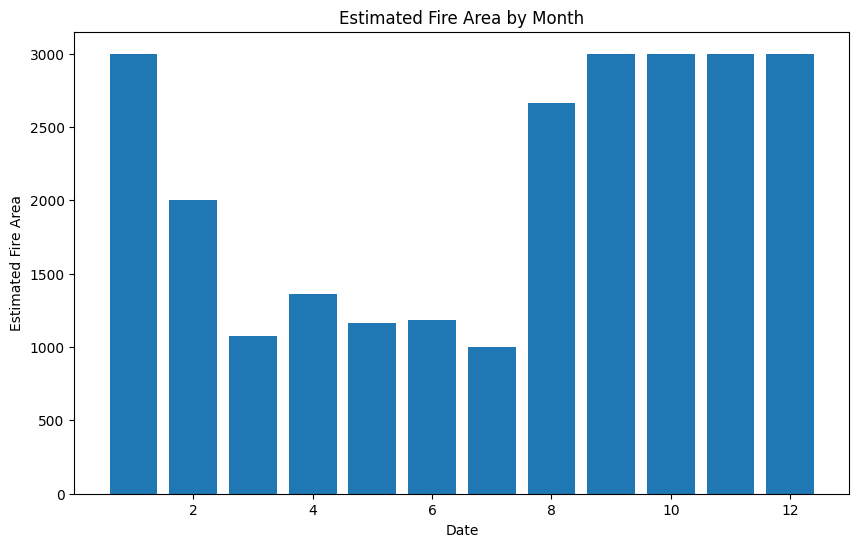

In [0]:
plt.figure(figsize=(10, 6))
plt.bar(Historical_Wildfires_df['Month'], Historical_Wildfires_df['Estimated_fire_area'])
plt.title('Estimated Fire Area by Month')
plt.xlabel('Date')
plt.ylabel('Estimated Fire Area')
plt.show()

#Australia has summer from september to january

In [0]:
Historical_Wildfires_df['Year'].value_counts()

2019    1858
2012    1806
2018    1780
2005    1743
2013    1726
2017    1710
2006    1693
2011    1665
2014    1665
2007    1662
2015    1625
2009    1602
2016    1584
2008    1546
2010    1461
2020    1280
Name: Year, dtype: int64

### Visualizing fire area for a Year

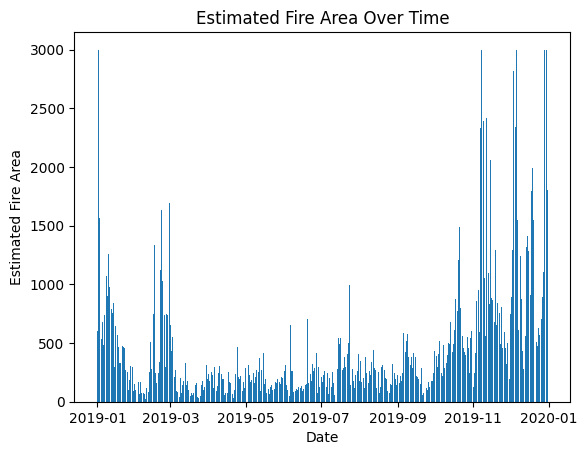

In [0]:
Historical_Wildfires7 = Historical_Wildfires_df[Historical_Wildfires_df['Year'] == 2019]
plt.bar(Historical_Wildfires7['Date'], Historical_Wildfires7['Estimated_fire_area'])
plt.title('Estimated Fire Area Over Time')
plt.xlabel('Date')
plt.ylabel('Estimated Fire Area')
plt.show()

## Weather Dataframe

In [0]:
weather_data.head()

,Date,Region,Precipitation_Max,Precipitation_Mean,Precipitation_Min,Precipitation_Variance,RelativeHumidity_Max,RelativeHumidity_Mean,RelativeHumidity_Min,RelativeHumidity_Variance,SoilWaterContent_Max,SoilWaterContent_Mean,SoilWaterContent_Min,SoilWaterContent_Variance,SolarRadiation_Max,SolarRadiation_Mean,SolarRadiation_Min,SolarRadiation_Variance,Temperature_Max,Temperature_Mean,Temperature_Min,Temperature_Variance,WindSpeed_Max,WindSpeed_Mean,WindSpeed_Min,WindSpeed_Variance,Year,Month
0,2005-01-01,NSW,1.836935,0.044274,0.000000,0.028362,80.522964,36.355567,13.877194,253.559937,0.414305,0.170931,0.002245,0.007758,32.169781,26.749389,14.515009,6.078587,35.878704,27.341182,14.485785,18.562212,7.670482,3.323550,1.354448,0.850048,2005,1
1,2005-01-01,NT,315.266815,9.884958,0.000000,546.059262,95.683342,61.494675,14.558820,584.201131,0.496140,0.167735,0.000000,0.026743,31.634459,19.781791,2.518120,58.942658,38.136787,29.881492,24.179960,12.920252,9.704402,5.296892,1.840394,1.930014,2005,1
2,2005-01-01,QL,74.452164,1.453053,0.000000,35.641257,95.898270,47.959364,14.443199,403.134377,0.472416,0.185641,0.000000,0.012679,31.982830,27.056979,6.033827,29.500832,37.047943,28.842866,20.951620,13.792599,7.675632,3.483753,1.106028,0.883048,2005,1
3,2005-01-01,SA,3.193624,0.059078,0.000000,0.042837,81.980751,30.057683,10.618136,246.044713,0.263911,0.056047,0.000000,0.001917,31.734528,27.142643,17.861103,7.914246,38.326847,30.793675,14.095855,34.799336,10.044715,4.657538,2.023657,1.655908,2005,1
4,2005-01-01,TA,13.604791,3.099497,0.003973,12.068597,81.501442,65.086764,43.906574,111.754034,0.368189,0.211360,0.000000,0.007121,33.225517,26.755711,20.742302,12.826400,16.228510,11.788805,6.686816,4.912013,11.432408,5.408138,1.995647,2.963118,2005,1


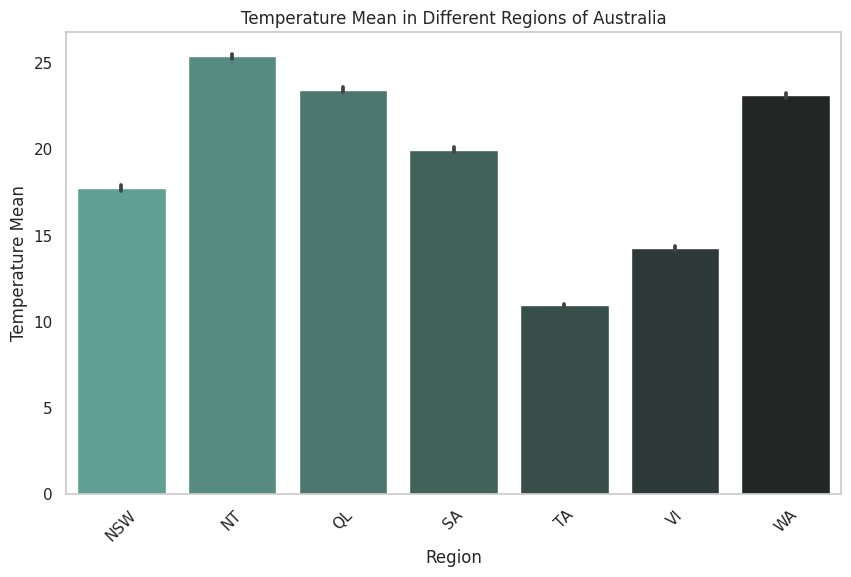

In [0]:
# Filter temperature mean for all regions
temperature_mean = weather_data['Temperature_Mean'].sort_values()
# Create a map of Australia using seaborn
sns.set(style='whitegrid')
plt.figure(figsize=(10, 6))
sns.barplot(x='Region', y=temperature_mean, data=weather_data, palette='dark:#5A9_r')
plt.title('Temperature Mean in Different Regions of Australia')
plt.xlabel('Region')
plt.ylabel('Temperature Mean')
plt.xticks(rotation=45)
plt.grid(False)

# Show the map
plt.show()


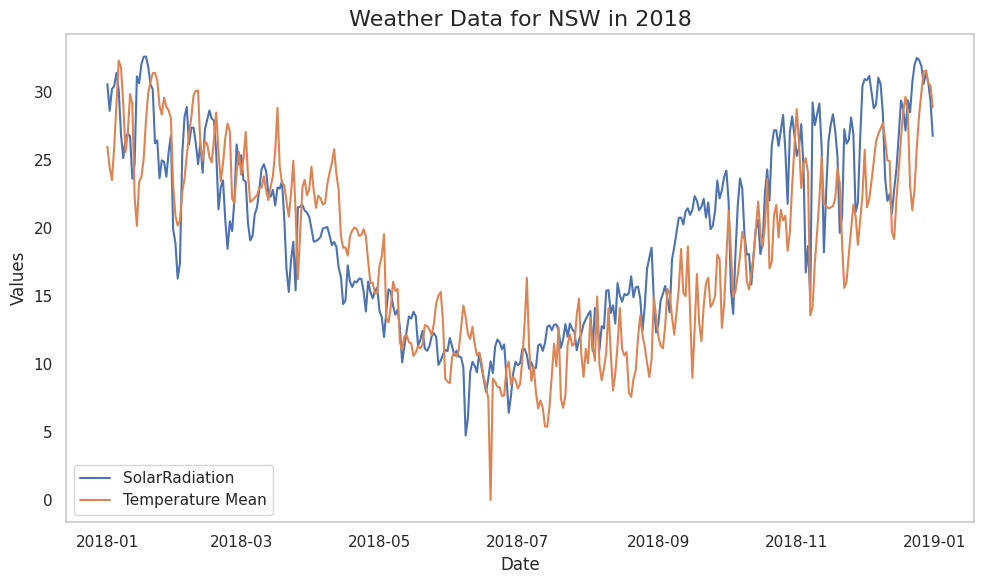

In [0]:
# Filter weather data for the year 2018
weather_data_2018 = weather_data.loc[weather_data['Year'] == 2018]

regions = weather_data_2018['Region'].unique()

region_data = weather_data_2018.loc[weather_data_2018['Region'] == 'NSW']

plt.figure(figsize=(10, 6)) 

plt.plot(region_data['Date'], region_data['SolarRadiation_Mean'])
plt.plot(region_data['Date'], region_data['Temperature_Mean'])

plt.title('Weather Data for NSW in 2018', fontsize=16)  
plt.xlabel('Date', fontsize=12)  
plt.ylabel('Values', fontsize=12)  
plt.legend(['SolarRadiation', 'Temperature Mean'], loc='best')  
plt.tight_layout()
plt.grid(False)

plt.show()

## Vegetation Dataframe

In [0]:
VegetationIndex_df.head(10)

,Region,Date,Vegetation_index_mean,Vegetation_index_max,Vegetation_index_min,Vegetation_index_std,Vegetation_index_variance,Year,Month
0,NSW,2005-01-01,0.349202,0.9972,-0.2,0.204862,0.041968,2005,1
1,NSW,2005-02-01,0.357403,0.9772,-0.2,0.208673,0.043544,2005,2
2,NSW,2005-03-01,0.354087,0.9750,-0.2,0.209450,0.043869,2005,3
3,NSW,2005-04-01,0.347242,0.9904,-0.2,0.207307,0.042976,2005,4
4,NSW,2005-05-01,0.345526,0.9972,-0.2,0.202858,0.041151,2005,5
5,NSW,2005-06-01,0.399652,0.9602,-0.2,0.188570,0.035559,2005,6
6,NSW,2005-07-01,0.451143,0.9555,-0.2,0.174267,0.030369,2005,7
7,NSW,2005-08-01,0.498218,0.9782,-0.2,0.181103,0.032798,2005,8
8,NSW,2005-09-01,0.505553,0.9805,-0.2,0.204202,0.041698,2005,9
9,NSW,2005-10-01,0.439443,0.9814,-0.2,0.214671,0.046084,2005,10


#### Checking for Missing values

In [0]:
#Create reference date range
start_date = VegetationIndex_df.index.min()
end_date = VegetationIndex_df.index.max()
expected_dates = pd.date_range(start=start_date, end=end_date)

# Check for missing dates
missing_dates = expected_dates.difference(VegetationIndex_df.index)

if len(missing_dates) == 0:
    print("All dates are present continuously in the time series.")
else:
    print("Some dates are missing in the time series:")
    print("Number of missing dates:", len(missing_dates))
# no missing values. 1970 is shown as missing. i think it is fine

Some dates are missing in the time series:
Number of missing dates: 1


### Vegetation Index by Region

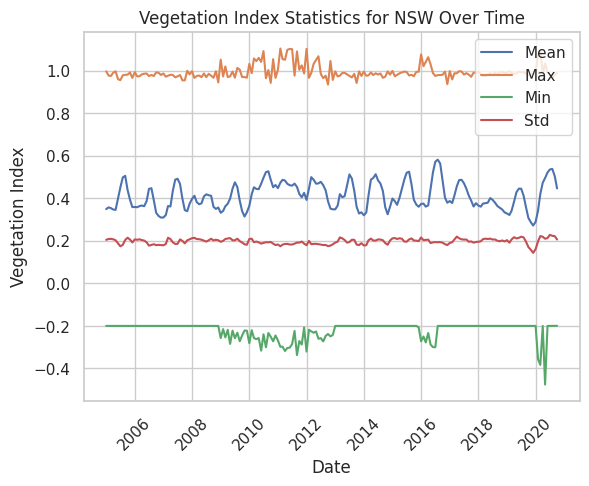

In [0]:
nsw_data = VegetationIndex_df[VegetationIndex_df['Region'] == 'NSW']

plt.plot(nsw_data['Date'], nsw_data['Vegetation_index_mean'], label='Mean')
plt.plot(nsw_data['Date'], nsw_data['Vegetation_index_max'], label='Max')
plt.plot(nsw_data['Date'], nsw_data['Vegetation_index_min'], label='Min')
plt.plot(nsw_data['Date'], nsw_data['Vegetation_index_std'], label='Std')

plt.xlabel('Date')
plt.ylabel('Vegetation Index')
plt.title('Vegetation Index Statistics for NSW Over Time')
plt.legend()
plt.xticks(rotation=45)
plt.show()


# Feature Engineering

## Correlations
### Landclass Dataframe

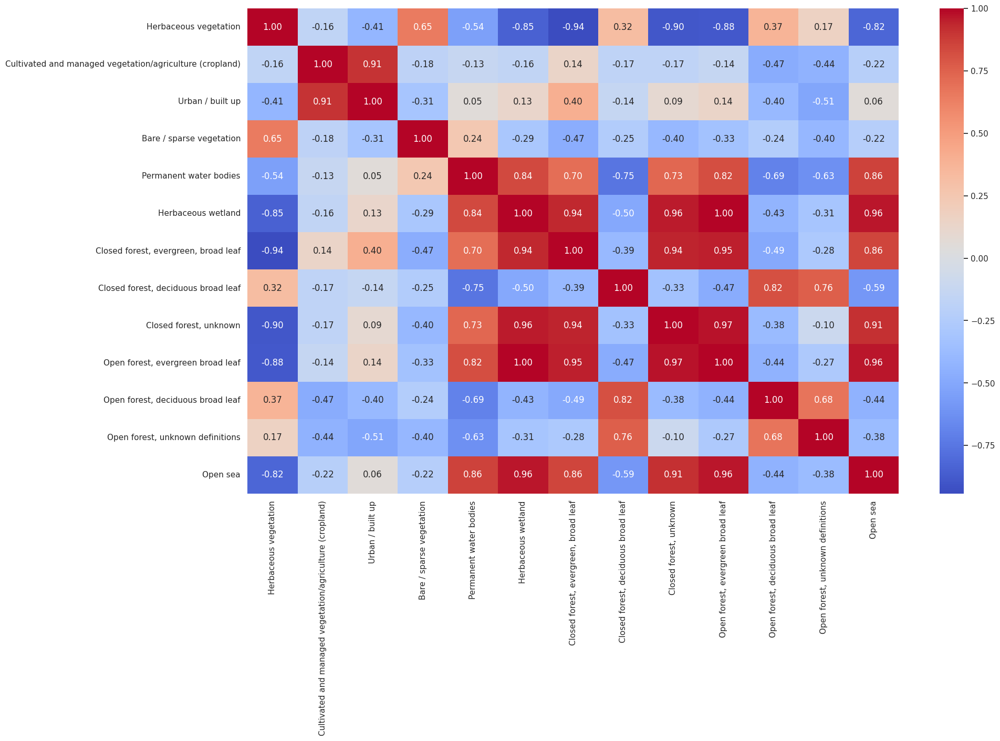

In [0]:
Landcorr1 = LandClass_df.drop(['Region'], axis = 1)
Landcorr1.reset_index(drop=True, inplace=True)
land_matrix = Landcorr1.corr()

plt.figure(figsize=(20, 12))
sns.heatmap(land_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.show()

In [0]:
# Dropping columns - Multicollinearity
LandClass_data = LandClass_df.drop(['Urban / built up', 'Open forest, evergreen broad leaf','Herbaceous vegetation', 'Open sea', 'Closed forest, evergreen, broad leaf', 'Herbaceous wetland','Open forest, deciduous broad leaf','Open forest, unknown definitions','Closed forest, unknown' ], axis = 1)

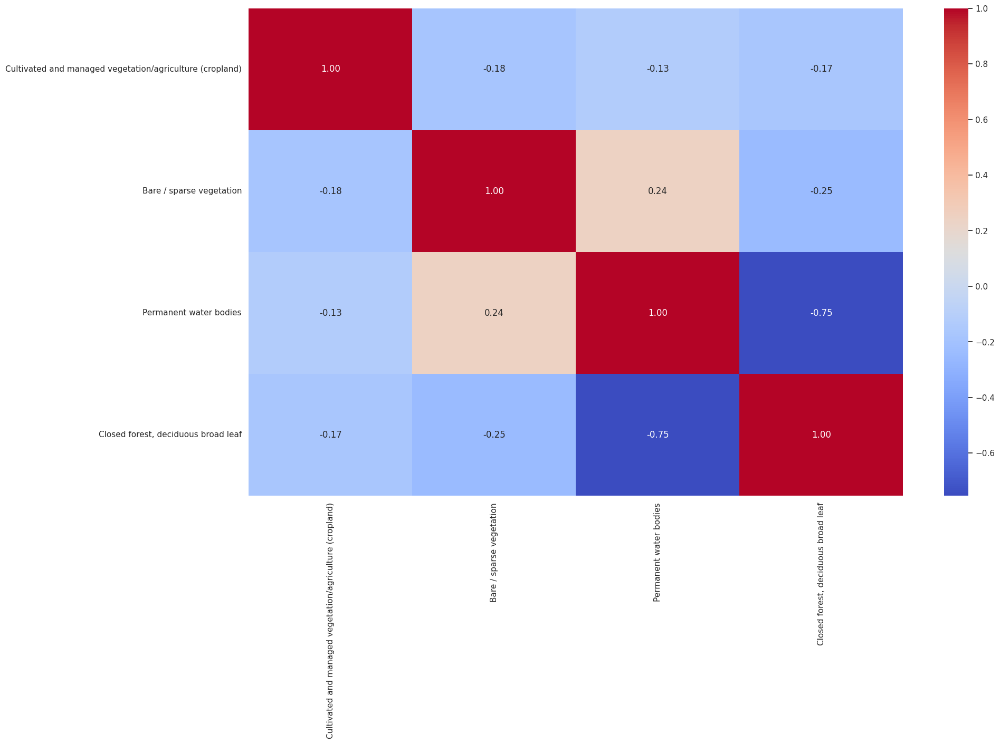

In [0]:
Landcorr2 = LandClass_data.drop(['Region'], axis = 1)
Landcorr2.reset_index(drop=True, inplace=True)
land_matrix2 = LandClass_data.corr()


plt.figure(figsize=(20, 12))
sns.heatmap(land_matrix2, annot=True, cmap='coolwarm', fmt=".2f")
plt.show()

### Weather Dataframe

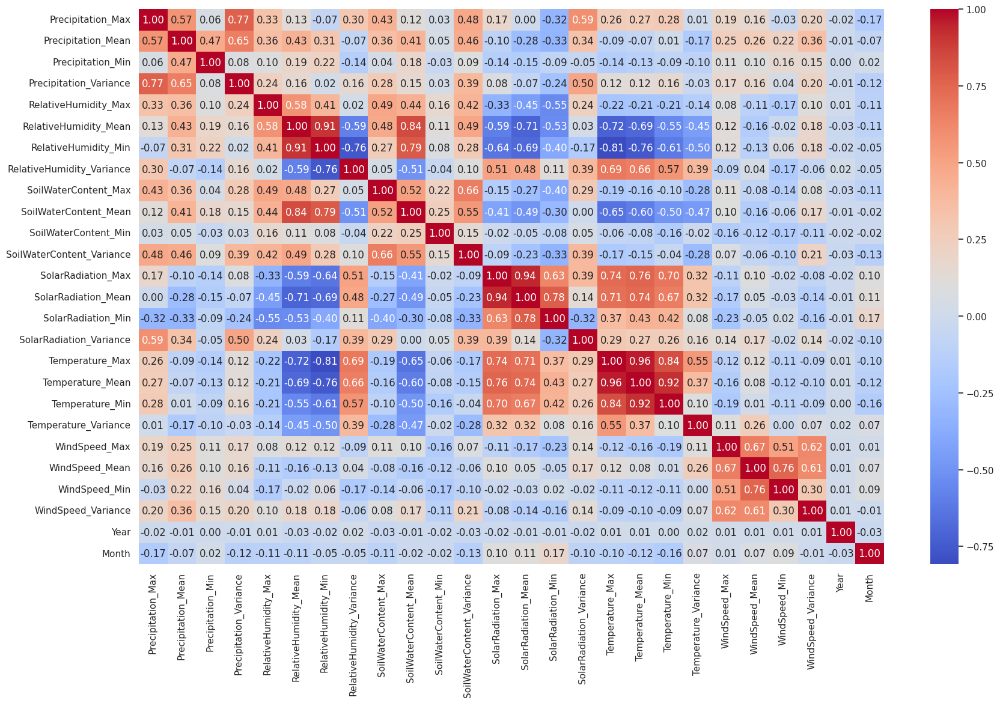

In [0]:
weathercorr1 = weather_data.drop(['Region','Date'], axis = 1)
weathercorr1.reset_index(drop=True, inplace=True)
weather_matrix = weathercorr1.corr()

plt.figure(figsize=(20, 12))
sns.heatmap(weather_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.show()

In [0]:
# Dropping columns - Multicollinearity
weather_df1 = weather_data.drop(['Precipitation_Variance', 'RelativeHumidity_Variance', 'SoilWaterContent_Variance', 'SolarRadiation_Variance','SolarRadiation_Min', 'Temperature_Variance', 'WindSpeed_Variance', 'RelativeHumidity_Min', 'RelativeHumidity_Max', 'SolarRadiation_Max', 'Temperature_Min', 'Temperature_Max', 'SoilWaterContent_Mean', 'WindSpeed_Min'], axis=1)

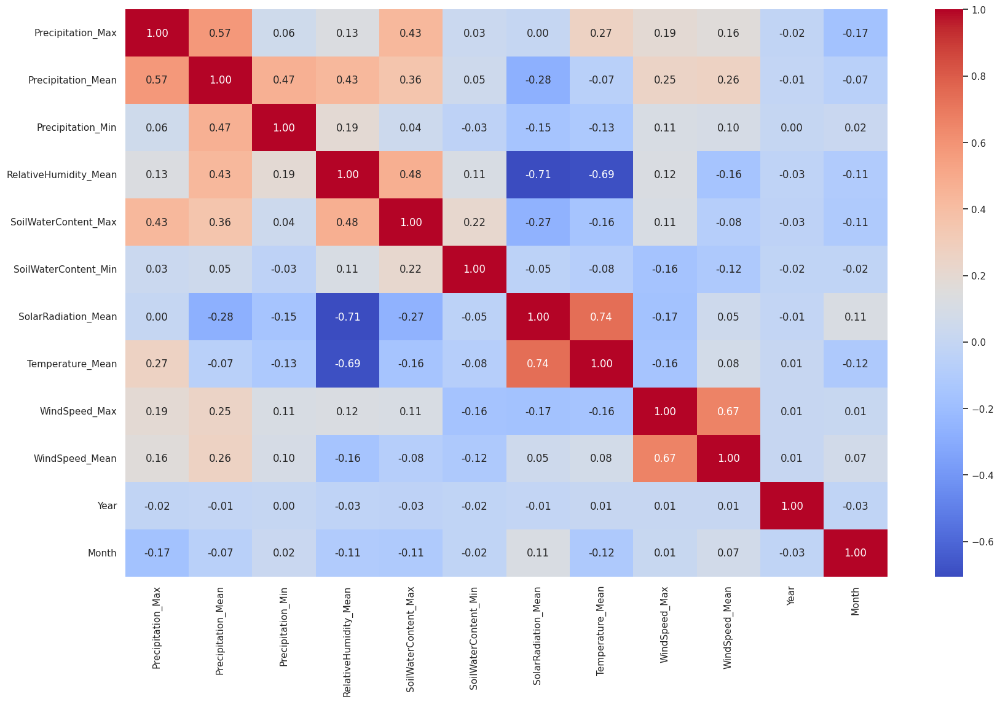

In [0]:
weathercorr2 = weather_df1.drop(['Region','Date'], axis = 1)
weathercorr2.reset_index(drop=True, inplace=True)
weather_matrix1 = weathercorr2.corr()


plt.figure(figsize=(20, 12))
sns.heatmap(weather_matrix1, annot=True, cmap='coolwarm', fmt=".2f")
plt.show()

### Vegetation Dataframe

In [0]:
# Dropping due to Multicollinearity
VegetationIndex_df.drop(['Vegetation_index_variance'], inplace=True, axis=1)

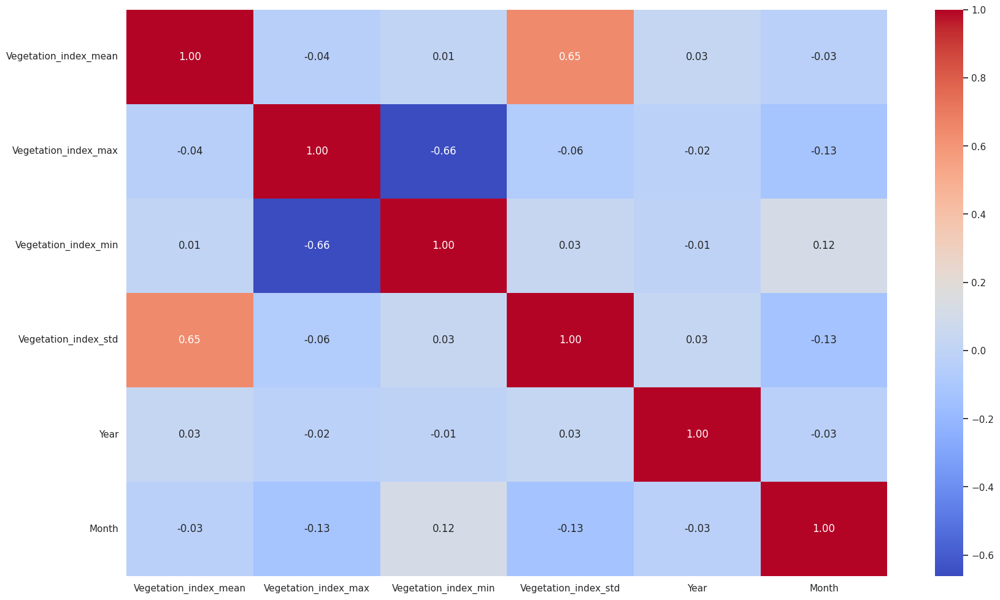

In [0]:
Vegcorr1 = VegetationIndex_df.drop(['Region','Date'], axis = 1)
Vegcorr1.reset_index(drop=True, inplace=True)
veg_matrix = Vegcorr1.corr()

plt.figure(figsize=(20, 12))
sns.heatmap(veg_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.show()

# Joining the tables

In [0]:
df_all1 = weather_df1.join(LandClass_data.set_index('Region'), on='Region', how='left')

In [0]:
df_all1.shape

(40481, 19)

In [0]:
df_all1.columns

Index(['Date', 'Region', 'Precipitation_Max', 'Precipitation_Mean',
       'Precipitation_Min', 'RelativeHumidity_Mean', 'SoilWaterContent_Max',
       'SoilWaterContent_Min', 'SolarRadiation_Mean', 'Temperature_Mean',
       'WindSpeed_Max', 'WindSpeed_Mean', 'Year', 'Month', 'Shrubs',
       'Cultivated and managed vegetation/agriculture (cropland)',
       'Bare / sparse vegetation', 'Permanent water bodies',
       'Closed forest, deciduous broad leaf'],
      dtype='object')

In [0]:
df_all2 = pd.merge(df_all1, VegetationIndex_df, on=['Region', 'Year', 'Month'], how='left')

In [0]:
df_all2.columns

Index(['Date_x', 'Region', 'Precipitation_Max', 'Precipitation_Mean',
       'Precipitation_Min', 'RelativeHumidity_Mean', 'SoilWaterContent_Max',
       'SoilWaterContent_Min', 'SolarRadiation_Mean', 'Temperature_Mean',
       'WindSpeed_Max', 'WindSpeed_Mean', 'Year', 'Month', 'Shrubs',
       'Cultivated and managed vegetation/agriculture (cropland)',
       'Bare / sparse vegetation', 'Permanent water bodies',
       'Closed forest, deciduous broad leaf', 'Date_y',
       'Vegetation_index_mean', 'Vegetation_index_max', 'Vegetation_index_min',
       'Vegetation_index_std'],
      dtype='object')

In [0]:
df_all2.drop(['Date_y'], axis=1,inplace=True )
df_all2.rename(columns={'Date_x': 'Date'}, inplace=True)

In [0]:
df_all = pd.merge(df_all2, Historical_Wildfires_df, on=['Region', 'Date'], how='left')

In [0]:
df_all.shape

(40481, 26)

In [0]:
df_all.columns

Index(['Date', 'Region', 'Precipitation_Max', 'Precipitation_Mean',
       'Precipitation_Min', 'RelativeHumidity_Mean', 'SoilWaterContent_Max',
       'SoilWaterContent_Min', 'SolarRadiation_Mean', 'Temperature_Mean',
       'WindSpeed_Max', 'WindSpeed_Mean', 'Year_x', 'Month_x', 'Shrubs',
       'Cultivated and managed vegetation/agriculture (cropland)',
       'Bare / sparse vegetation', 'Permanent water bodies',
       'Closed forest, deciduous broad leaf', 'Vegetation_index_mean',
       'Vegetation_index_max', 'Vegetation_index_min', 'Vegetation_index_std',
       'Estimated_fire_area', 'Year_y', 'Month_y'],
      dtype='object')

In [0]:
df_all.drop(['Year_y', 'Month_y'], axis = 1, inplace=True)
df_all.rename(columns={'Year_x': 'Year', 'Month_x': 'Month'}, inplace=True)

In [0]:
df_all.head(5)

,Date,Region,Precipitation_Max,Precipitation_Mean,Precipitation_Min,RelativeHumidity_Mean,SoilWaterContent_Max,SoilWaterContent_Min,SolarRadiation_Mean,Temperature_Mean,WindSpeed_Max,WindSpeed_Mean,Year,Month,Shrubs,Cultivated and managed vegetation/agriculture (cropland),Bare / sparse vegetation,Permanent water bodies,"Closed forest, deciduous broad leaf",Vegetation_index_mean,Vegetation_index_max,Vegetation_index_min,Vegetation_index_std,Estimated_fire_area
0,2005-01-01,NSW,1.836935,0.044274,0.000000,36.355567,0.414305,0.002245,26.749389,27.341182,7.670482,3.323550,2005,1,6.2,13.0,0.2,0.2,6.8,0.349202,0.9972,-0.2,0.204862,NaN
1,2005-01-01,NT,315.266815,9.884958,0.000000,61.494675,0.496140,0.000000,19.781791,29.881492,9.704402,5.296892,2005,1,18.1,0.1,0.4,0.1,7.7,0.300478,0.9986,-0.2,0.152621,4.945000
2,2005-01-01,QL,74.452164,1.453053,0.000000,47.959364,0.472416,0.000000,27.056979,28.842866,7.675632,3.483753,2005,1,9.5,1.6,1.1,0.1,13.3,0.357081,0.9995,-0.2,0.181695,38.831579
3,2005-01-01,SA,3.193624,0.059078,0.000000,30.057683,0.263911,0.000000,27.142643,30.793675,10.044715,4.657538,2005,1,24.1,5.8,4.8,1.2,1.3,0.179208,0.9634,-0.2,0.076393,NaN
4,2005-01-01,TA,13.604791,3.099497,0.003973,65.086764,0.368189,0.000000,26.755711,11.788805,11.432408,5.408138,2005,1,0.7,1.2,0.1,1.9,0.6,0.638585,0.9920,-0.2,0.169840,NaN


In [0]:
# Check for missing values in df_all
df_all.isnull().sum()

Date                                                            0
Region                                                          0
Precipitation_Max                                               0
Precipitation_Mean                                              0
Precipitation_Min                                               0
RelativeHumidity_Mean                                           0
SoilWaterContent_Max                                            0
SoilWaterContent_Min                                            0
SolarRadiation_Mean                                             0
Temperature_Mean                                                0
WindSpeed_Max                                                   0
WindSpeed_Mean                                                  0
Year                                                            0
Month                                                           0
Shrubs                                                          0
Cultivated

The missing values indicate that there were no forest fires during those dates. So imputing the area with o

In [0]:
df_all['Estimated_fire_area'].fillna(0, inplace=True)

### Checking for Correlation in the final Dataset

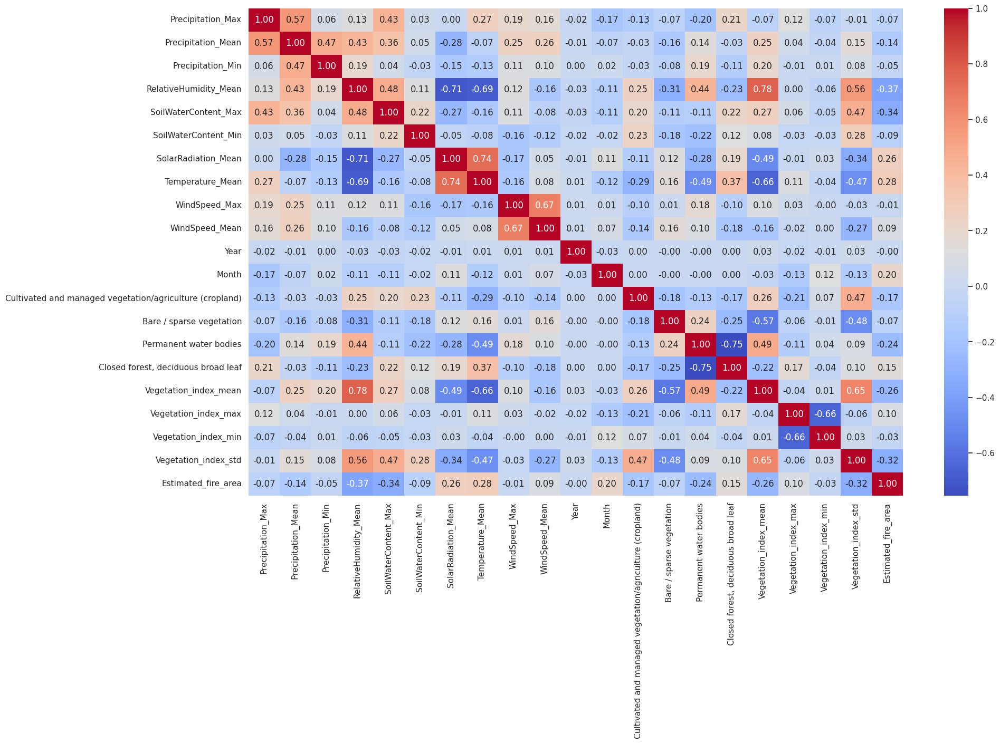

In [0]:
corr = df_all.drop(['Region','Date'], axis = 1)
corr.reset_index(drop=True, inplace=True)
matrix = corr.corr()

plt.figure(figsize=(20, 12))
sns.heatmap(matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.show()

## Normalizing the Dataset

In [0]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder


In [0]:
print(df_all.columns)
df_all.dtypes

Index(['Date', 'Region', 'Precipitation_Max', 'Precipitation_Mean',
       'Precipitation_Min', 'RelativeHumidity_Mean', 'SoilWaterContent_Max',
       'SoilWaterContent_Min', 'SolarRadiation_Mean', 'Temperature_Mean',
       'WindSpeed_Max', 'WindSpeed_Mean', 'Year', 'Month', 'Shrubs',
       'Cultivated and managed vegetation/agriculture (cropland)',
       'Bare / sparse vegetation', 'Permanent water bodies',
       'Closed forest, deciduous broad leaf', 'Vegetation_index_mean',
       'Vegetation_index_max', 'Vegetation_index_min', 'Vegetation_index_std',
       'Estimated_fire_area'],
      dtype='object')


Date                                                        datetime64[ns]
Region                                                              object
Precipitation_Max                                                  float64
Precipitation_Mean                                                 float64
Precipitation_Min                                                  float64
RelativeHumidity_Mean                                              float64
SoilWaterContent_Max                                               float64
SoilWaterContent_Min                                               float64
SolarRadiation_Mean                                                float64
Temperature_Mean                                                   float64
WindSpeed_Max                                                      float64
WindSpeed_Mean                                                     float64
Year                                                                 int64
Month                    

### LabelEncoding

In [0]:
label_encoder = LabelEncoder()

# Fit and transform both 'Region' and 'Shrubs' columns
df_all['Region'] = label_encoder.fit_transform(df_all['Region'])

# Now, you can generate label mappings
region_label_mapping = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))


print("Region Label Mapping:", region_label_mapping)

Region Label Mapping: {'NSW': 0, 'NT': 1, 'QL': 2, 'SA': 3, 'TA': 4, 'VI': 5, 'WA': 6}


In [0]:
df_all.dtypes

Date                                                        datetime64[ns]
Region                                                               int64
Precipitation_Max                                                  float64
Precipitation_Mean                                                 float64
Precipitation_Min                                                  float64
RelativeHumidity_Mean                                              float64
SoilWaterContent_Max                                               float64
SoilWaterContent_Min                                               float64
SolarRadiation_Mean                                                float64
Temperature_Mean                                                   float64
WindSpeed_Max                                                      float64
WindSpeed_Mean                                                     float64
Year                                                                 int64
Month                    

## Conducting Causality Tests on all variables

### Adfuller Test - to test is timeseries in Stationary

In [0]:
from statsmodels.tsa.stattools import grangercausalitytests
from statsmodels.tsa.stattools import adfuller

In [0]:
df_nots = df_all.drop('Date')

In [0]:
#Perform Adfuller test on each column of the dataframe
for i in range(len(df_all.columns)):
   result = adfuller(df_all[df_all.columns[i]])

    #Check the p-value of the test result
    #If the p-value is greater than 0.05, the series is not stationary
   if result[1] > 0.05:
       print("{} - Series is not Stationary".format(df_all.columns[i]))
   else:
       print("{} - Series is Stationary".format(df_all.columns[i]))

Date - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Region - Series is not Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Precipitation_Max - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)
/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Precipitation_Mean - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Precipitation_Min - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


RelativeHumidity_Mean - Series is Stationary
SoilWaterContent_Max - Series is Stationary
SoilWaterContent_Min - Series is Stationary
SolarRadiation_Mean - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


SolarRadiation_Min - Series is Stationary
Temperature_Mean - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


WindSpeed_Max - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


WindSpeed_Mean - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


WindSpeed_Min - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Year_x - Series is not Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)
/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Month_x - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Day_x - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Shrubs - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)
/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Cultivated and managed vegetation/agriculture (cropland) - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)
/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Bare / sparse vegetation - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Permanent water bodies - Series is Stationary
Closed forest, deciduous broad leaf - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Open forest, evergreen broad leaf - Series is not Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)
/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Open forest, deciduous broad leaf - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)
/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Open forest, unknown definitions - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)
/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Vegetation_index_mean - Series is Stationary
Vegetation_index_max - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)
/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)
/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureT

Vegetation_index_min - Series is Stationary


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Vegetation_index_std - Series is Stationary
Estimated_fire_area - Series is Stationary


## Granger Causality Test

In [0]:
max_lags = 10
y = "Estimated_fire_area"

In [0]:
df_sample = df_all.drop(['Date'],axis=1)

In [0]:
for i in range(len(df_sample.columns)-1):
   results = grangercausalitytests(df_sample[[y, df_sample.columns[i+1]]], max_lags, verbose=False)
   p_values = [round(results[i+1][0]["ssr_ftest"][1],4) for i in range(max_lags)]
   print("Column - {}: P_values - {}".format(df_sample.columns[i+1], p_values))

Column - Precipitation_Max: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Column - Precipitation_Mean: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)
/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Column - Precipitation_Min: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0001, 0.0001, 0.0, 0.0]
Column - RelativeHumidity_Mean: P_values - [0.8684, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Column - SoilWaterContent_Max: P_values - [0.0004, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Column - SoilWaterContent_Min: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Column - SolarRadiation_Mean: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Column - SolarRadiation_Min: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Column - Temperature_Mean: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Column - WindSpeed_Max: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Column - WindSpeed_Mean: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Column - WindSpeed_Min: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Column - Year_x: P_values - [0.9652, 0.9789, 0.9742, 0.8044, 0.6386, 0.7454, 0.0855, 0.1276, 0.1861, 0.0858]


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)


Column - Month_x: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Column - Day_x: P_values - [0.5661, 0.81, 0.8313, 0.9305, 0.9754, 0.9899, 0.9231, 0.8548, 0.8095, 0.8367]


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)
/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 8, but rank is 7
  warnings.warn('covariance of constraints does not have full '
/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 9, but rank is 7
  warnings.warn('covariance of constraints does not have full '
/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have

Column - Shrubs: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


/databricks/python/lib/python3.10/site-packages/databricks/feature_store/entities/_feature_store_object.py:9: FutureWarning: ``databricks.feature_store.entities.feature_table.FeatureTable.keys`` is deprecated since v0.3.6. This method will be removed in a future release. Use ``FeatureTable.primary_keys`` instead.
  yield prop, self.__getattribute__(prop)
/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 8, but rank is 7
  warnings.warn('covariance of constraints does not have full '
/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 9, but rank is 7
  warnings.warn('covariance of constraints does not have full '
/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have

Column - Cultivated and managed vegetation/agriculture (cropland): P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 8, but rank is 7
  warnings.warn('covariance of constraints does not have full '
/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 9, but rank is 7
  warnings.warn('covariance of constraints does not have full '
/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 10, but rank is 7
  warnings.warn('covariance of constraints does not have full '


Column - Bare / sparse vegetation: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 8, but rank is 7
  warnings.warn('covariance of constraints does not have full '
/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 9, but rank is 7
  warnings.warn('covariance of constraints does not have full '
/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 10, but rank is 7
  warnings.warn('covariance of constraints does not have full '


Column - Permanent water bodies: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 8, but rank is 7
  warnings.warn('covariance of constraints does not have full '
/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 9, but rank is 7
  warnings.warn('covariance of constraints does not have full '
/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 10, but rank is 7
  warnings.warn('covariance of constraints does not have full '


Column - Closed forest, deciduous broad leaf: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 8, but rank is 7
  warnings.warn('covariance of constraints does not have full '
/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 9, but rank is 7
  warnings.warn('covariance of constraints does not have full '
/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 10, but rank is 7
  warnings.warn('covariance of constraints does not have full '


Column - Open forest, deciduous broad leaf: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 8, but rank is 7
  warnings.warn('covariance of constraints does not have full '
/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 9, but rank is 7
  warnings.warn('covariance of constraints does not have full '
/databricks/python/lib/python3.10/site-packages/statsmodels/base/model.py:1871: ValueWarning: covariance of constraints does not have full rank. The number of constraints is 10, but rank is 7
  warnings.warn('covariance of constraints does not have full '


Column - Open forest, unknown definitions: P_values - [0.0052, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Column - Vegetation_index_mean: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Column - Vegetation_index_max: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Column - Vegetation_index_min: P_values - [0.2436, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Column - Vegetation_index_std: P_values - [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
Column - Estimated_fire_area: P_values - [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


In [0]:
df_all.drop(['RelativeHumidity_Mean'], axis=1, inplace=True)

In [0]:
display(df_all)

Date,Region,Precipitation_Max,Precipitation_Mean,Precipitation_Min,SoilWaterContent_Max,SoilWaterContent_Min,SolarRadiation_Mean,Temperature_Mean,WindSpeed_Max,WindSpeed_Mean,Year,Month,Shrubs,Cultivated and managed vegetation/agriculture (cropland),Bare / sparse vegetation,Permanent water bodies,"Closed forest, deciduous broad leaf",Vegetation_index_mean,Vegetation_index_max,Vegetation_index_min,Vegetation_index_std,Estimated_fire_area
2005-01-01T00:00:00Z,0,1.83693528175354,0.044274442233515995,0.0,0.414304912090302,0.002244789851829,26.749388640628453,27.34118187347965,7.6704816818237305,3.3235495014184777,2005,1,6.2,13.0,0.2,0.2,6.8,0.349202013,0.997199953,-0.199999988,0.204861658,0.0
2005-01-01T00:00:00Z,1,315.2668151855469,9.884957682481286,0.0,0.496140271425247,0.0,19.78179070248108,29.88149218395819,9.704401969909668,5.296891761974689,2005,1,18.1,0.1,0.4,0.1,7.7,0.300478332,0.998599946,-0.199999988,0.152620601,4.945
2005-01-01T00:00:00Z,2,74.45216369628906,1.453052700944846,0.0,0.47241625189781206,0.0,27.05697868021628,28.84286596072678,7.675631999969482,3.483753305650359,2005,1,9.5,1.6,1.1,0.1,13.3,0.357080666,0.999499977,-0.199999988,0.181694601,38.83157895
2005-01-01T00:00:00Z,3,3.1936244964599614,0.05907846285384501,0.0,0.263910830020905,0.0,27.14264252913578,30.793675222828547,10.04471492767334,4.65753846667346,2005,1,24.1,5.8,4.8,1.2,1.3,0.179208243,0.963399947,-0.199999988,0.07639274,0.0
2005-01-01T00:00:00Z,4,13.604790687561035,3.099497068910544,0.003972991835326,0.368189066648483,0.0,26.75571119931565,11.78880460068683,11.432408332824707,5.408137732760589,2005,1,0.7,1.2,0.1,1.9,0.6,0.638585396,0.991999984,-0.199999988,0.169840138,0.0
2005-01-01T00:00:00Z,5,1.129022598266602,0.05202351351541901,0.0,0.389526903629303,0.0,24.623813329999344,17.084567628209008,9.830580711364746,3.655508479497904,2005,1,1.4,23.3,0.1,0.6,3.8,0.430316621,0.99119997,-0.199999988,0.203939458,0.0
2005-01-01T00:00:00Z,6,127.79518127441406,1.8724147486695157,0.0,0.405102074146271,0.0,26.967495061198488,28.524054822596568,10.65023708343506,4.2010390340744825,2005,1,31.3,5.6,1.0,0.4,2.4,0.219955687,0.996799946,-0.199999988,0.097230953,36.3825
2005-01-02T00:00:00Z,0,6.854537010192871,0.173878952258094,0.0,0.404070645570755,0.001209517358802,27.047523006324862,26.14389774330848,7.448904991149902,3.0308973946425133,2005,1,6.2,13.0,0.2,0.2,6.8,0.349202013,0.997199953,-0.199999988,0.204861658,0.0
2005-01-02T00:00:00Z,1,89.89837646484374,8.061692227672813,0.0,0.501194834709167,5.487818270000001E-7,19.321221910710577,28.86375997193252,9.320925712585447,4.912402752002473,2005,1,18.1,0.1,0.4,0.1,7.7,0.300478332,0.998599946,-0.199999988,0.152620601,1.32
2005-01-02T00:00:00Z,2,87.77549743652342,1.5446067856884258,0.0,0.477547913789749,0.0,26.276293678641,29.41644928641221,7.094273567199707,3.14595356146437,2005,1,9.5,1.6,1.1,0.1,13.3,0.357080666,0.999499977,-0.199999988,0.181694601,64.46428571


In [0]:
df_all.columns = df_all.columns.str.replace('[,;{}()\n\t= ]', '_', regex=True)

In [0]:
df_all

,Date,Region,Precipitation_Max,Precipitation_Mean,Precipitation_Min,SoilWaterContent_Max,SoilWaterContent_Min,SolarRadiation_Mean,Temperature_Mean,WindSpeed_Max,WindSpeed_Mean,Year,Month,Shrubs,Cultivated_and_managed_vegetation/agriculture__cropland_,Bare_/_sparse_vegetation,Permanent_water_bodies,Closed_forest__deciduous_broad_leaf,Vegetation_index_mean,Vegetation_index_max,Vegetation_index_min,Vegetation_index_std,Estimated_fire_area
0,2005-01-01,0,1.836935,0.044274,0.000000,0.414305,0.002245,26.749389,27.341182,7.670482,3.323550,2005,1,6.2,13.0,0.2,0.2,6.8,0.349202,0.9972,-0.2000,0.204862,0.000000
1,2005-01-01,1,315.266815,9.884958,0.000000,0.496140,0.000000,19.781791,29.881492,9.704402,5.296892,2005,1,18.1,0.1,0.4,0.1,7.7,0.300478,0.9986,-0.2000,0.152621,4.945000
2,2005-01-01,2,74.452164,1.453053,0.000000,0.472416,0.000000,27.056979,28.842866,7.675632,3.483753,2005,1,9.5,1.6,1.1,0.1,13.3,0.357081,0.9995,-0.2000,0.181695,38.831579
3,2005-01-01,3,3.193624,0.059078,0.000000,0.263911,0.000000,27.142643,30.793675,10.044715,4.657538,2005,1,24.1,5.8,4.8,1.2,1.3,0.179208,0.9634,-0.2000,0.076393,0.000000
4,2005-01-01,4,13.604791,3.099497,0.003973,0.368189,0.000000,26.755711,11.788805,11.432408,5.408138,2005,1,0.7,1.2,0.1,1.9,0.6,0.638585,0.9920,-0.2000,0.169840,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40476,2020-10-31,2,26.366877,0.386800,0.000000,0.442840,0.000000,28.745128,24.777835,7.643718,3.137745,2020,10,9.5,1.6,1.1,0.1,13.3,0.289288,0.9954,-0.2000,0.140747,297.627826
40477,2020-10-31,3,0.259189,0.006940,0.000000,0.436347,0.000000,26.530568,18.947783,7.620720,3.548225,2020,10,24.1,5.8,4.8,1.2,1.3,0.243616,0.9926,-0.2000,0.100569,0.000000
40478,2020-10-31,4,2.179307,0.472709,0.000703,0.376833,0.000000,21.782732,11.648813,7.388186,2.501697,2020,10,0.7,1.2,0.1,1.9,0.6,0.715092,0.9962,-0.2000,0.142757,0.000000
40479,2020-10-31,5,11.436618,0.822028,0.000000,0.455111,0.000000,19.553751,13.167147,6.605598,3.838360,2020,10,1.4,23.3,0.1,0.6,3.8,0.627716,0.9929,-0.1992,0.192436,0.000000


In [0]:
# Generating 7 different dataframes based on the values of Region
NSW = df_all[df_all['Region'] == 0]
NT = df_all[df_all['Region'] == 1]
QL = df_all[df_all['Region'] == 2]
SA = df_all[df_all['Region'] == 3]
TA = df_all[df_all['Region'] == 4]
VI = df_all[df_all['Region'] == 5]
WA = df_all[df_all['Region'] == 6]

In [0]:
spark.sql("CREATE DATABASE IF NOT EXISTS australianwildfires")

DataFrame[]

In [0]:
#CONVERTING IN ON A SPARK DATAFRAME
df_all_spark = spark.createDataFrame(df_all)
NSW_spark = spark.createDataFrame(NSW)
NT_spark = spark.createDataFrame(NT)
QL_spark = spark.createDataFrame(QL)
SA_spark = spark.createDataFrame(SA)
TA_spark = spark.createDataFrame(TA)
VI_spark = spark.createDataFrame(VI)
WA_spark = spark.createDataFrame(WA)

In [0]:
spark.sql("DROP TABLE IF EXISTS australianwildfires.allregions")

# Create a temporary view from label_spark_df
df_all_spark.createOrReplaceTempView("temp_view")

# Convert the temporary view to a table
spark.sql("CREATE TABLE australianwildfires.allregions AS SELECT * FROM temp_view")

DataFrame[num_affected_rows: bigint, num_inserted_rows: bigint]

In [0]:
spark.sql("DROP TABLE IF EXISTS australianwildfires.NSW")
NSW_spark.createOrReplaceTempView("temp_view1")
spark.sql("CREATE TABLE australianwildfires.NSW AS SELECT * FROM temp_view1")

spark.sql("DROP TABLE IF EXISTS australianwildfires.NT")
NT_spark.createOrReplaceTempView("temp_view2")
spark.sql("CREATE TABLE australianwildfires.NT AS SELECT * FROM temp_view2")

spark.sql("DROP TABLE IF EXISTS australianwildfires.QL")
QL_spark.createOrReplaceTempView("temp_view3")
spark.sql("CREATE TABLE australianwildfires.QL AS SELECT * FROM temp_view3")

spark.sql("DROP TABLE IF EXISTS australianwildfires.SA")
SA_spark.createOrReplaceTempView("temp_view4")
spark.sql("CREATE TABLE australianwildfires.SA AS SELECT * FROM temp_view4")

spark.sql("DROP TABLE IF EXISTS australianwildfires.TA")
TA_spark.createOrReplaceTempView("temp_view5")
spark.sql("CREATE TABLE australianwildfires.TA AS SELECT * FROM temp_view5")

spark.sql("DROP TABLE IF EXISTS australianwildfires.VI")
VI_spark.createOrReplaceTempView("temp_view6")
spark.sql("CREATE TABLE australianwildfires.VI AS SELECT * FROM temp_view6")

spark.sql("DROP TABLE IF EXISTS australianwildfires.WA")
WA_spark.createOrReplaceTempView("temp_view7")
spark.sql("CREATE TABLE australianwildfires.WA AS SELECT * FROM temp_view7")

DataFrame[num_affected_rows: bigint, num_inserted_rows: bigint]